In [1]:
from google.colab import drive
drive.mount('/content/drive')

import os
!pip install pydensecrf

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive
     |████████████████████████████████| 1.0MB 6.2MB/s 
  Created wheel for pydensecrf: filename=pydensecrf-1.0rc3-cp36-cp36m-linux_x86_64.whl size=2153742 sha256=d1e3d6aa89ec949531603a4976ae7dc2fc51ea6631fe17a2afa71427d8ddc2c8
  Stored in directory: /root/.cache/pip/wheels/92/6f/ec/5c49c25de8c42c872de50ff53582ba3ead850ce52a81e73ac7
Successfully built pydensecrf


In [2]:
###################################################### DEEPLABV3 #####################################################

# -*- coding: utf-8 -*-

""" Deeplabv3+ model for Keras.
This model is based on TF repo:
https://github.com/tensorflow/models/tree/master/research/deeplab
On Pascal VOC, original model gets to 84.56% mIOU
Now this model is only available for the TensorFlow backend,
due to its reliance on `SeparableConvolution` layers, but Theano will add
this layer soon.
MobileNetv2 backbone is based on this repo:
https://github.com/JonathanCMitchell/mobilenet_v2_keras
# Reference
- [Encoder-Decoder with Atrous Separable Convolution
    for Semantic Image Segmentation](https://arxiv.org/pdf/1802.02611.pdf)
- [Xception: Deep Learning with Depthwise Separable Convolutions]
    (https://arxiv.org/abs/1610.02357)
- [Inverted Residuals and Linear Bottlenecks: Mobile Networks for
    Classification, Detection and Segmentation](https://arxiv.org/abs/1801.04381)
"""

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import numpy as np
import tensorflow as tf
from keras.utils import get_file

if tf.__version__[0] == "2":
    from tensorflow.keras.models import Model
    from tensorflow.keras.activations import relu
    from tensorflow.keras.layers import Layer, InputSpec, Conv2D, DepthwiseConv2D, UpSampling2D, ZeroPadding2D, Lambda, AveragePooling2D, Input, Activation, Concatenate, Add, Reshape, BatchNormalization, Dropout 
    from tensorflow.python.keras.engine import get_source_inputs
    from tensorflow.keras import backend as K
else:
    from keras.models import Model
    from keras.activations import relu
    from keras.layers import Conv2D, DepthwiseConv2D, UpSampling2D, ZeroPadding2D, Lambda, AveragePooling2D, Input, Activation, Concatenate, Add, Reshape, BatchNormalization, Dropout 
    from keras.engine import Layer, InputSpec
    from keras.engine.topology import get_source_inputs
    from keras import backend as K

WEIGHTS_PATH_X = "https://github.com/bonlime/keras-deeplab-v3-plus/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5"
WEIGHTS_PATH_MOBILE = "https://github.com/bonlime/keras-deeplab-v3-plus/releases/download/1.1/deeplabv3_mobilenetv2_tf_dim_ordering_tf_kernels.h5"



def SepConv_BN(x, filters, prefix, stride=1, kernel_size=3, rate=1, depth_activation=False, epsilon=1e-3):
    """ SepConv with BN between depthwise & pointwise. Optionally add activation after BN
        Implements right "same" padding for even kernel sizes
        Args:
            x: input tensor
            filters: num of filters in pointwise convolution
            prefix: prefix before name
            stride: stride at depthwise conv
            kernel_size: kernel size for depthwise convolution
            rate: atrous rate for depthwise convolution
            depth_activation: flag to use activation between depthwise & pointwise convs
            epsilon: epsilon to use in BN layer
    """

    if stride == 1:
        depth_padding = 'same'
    else:
        kernel_size_effective = kernel_size + (kernel_size - 1) * (rate - 1)
        pad_total = kernel_size_effective - 1
        pad_beg = pad_total // 2
        pad_end = pad_total - pad_beg
        x = ZeroPadding2D((pad_beg, pad_end))(x)
        depth_padding = 'valid'

    if not depth_activation:
        x = Activation('relu')(x)
    x = DepthwiseConv2D((kernel_size, kernel_size), strides=(stride, stride), dilation_rate=(rate, rate),
                        padding=depth_padding, use_bias=False, name=prefix + '_depthwise')(x)
    x = BatchNormalization(name=prefix + '_depthwise_BN', epsilon=epsilon)(x)
    if depth_activation:
        x = Activation('relu')(x)
    x = Conv2D(filters, (1, 1), padding='same',
               use_bias=False, name=prefix + '_pointwise')(x)
    x = BatchNormalization(name=prefix + '_pointwise_BN', epsilon=epsilon)(x)
    if depth_activation:
        x = Activation('relu')(x)

    return x


def _conv2d_same(x, filters, prefix, stride=1, kernel_size=3, rate=1):
    """Implements right 'same' padding for even kernel sizes
        Without this there is a 1 pixel drift when stride = 2
        Args:
            x: input tensor
            filters: num of filters in pointwise convolution
            prefix: prefix before name
            stride: stride at depthwise conv
            kernel_size: kernel size for depthwise convolution
            rate: atrous rate for depthwise convolution
    """
    if stride == 1:
        return Conv2D(filters,
                      (kernel_size, kernel_size),
                      strides=(stride, stride),
                      padding='same', use_bias=False,
                      dilation_rate=(rate, rate),
                      name=prefix)(x)
    else:
        kernel_size_effective = kernel_size + (kernel_size - 1) * (rate - 1)
        pad_total = kernel_size_effective - 1
        pad_beg = pad_total // 2
        pad_end = pad_total - pad_beg
        x = ZeroPadding2D((pad_beg, pad_end))(x)
        return Conv2D(filters,
                      (kernel_size, kernel_size),
                      strides=(stride, stride),
                      padding='valid', use_bias=False,
                      dilation_rate=(rate, rate),
                      name=prefix)(x)


def _xception_block(inputs, depth_list, prefix, skip_connection_type, stride,
                    rate=1, depth_activation=False, return_skip=False):
    """ Basic building block of modified Xception network
        Args:
            inputs: input tensor
            depth_list: number of filters in each SepConv layer. len(depth_list) == 3
            prefix: prefix before name
            skip_connection_type: one of {'conv','sum','none'}
            stride: stride at last depthwise conv
            rate: atrous rate for depthwise convolution
            depth_activation: flag to use activation between depthwise & pointwise convs
            return_skip: flag to return additional tensor after 2 SepConvs for decoder
            """
    residual = inputs
    for i in range(3):
        residual = SepConv_BN(residual,
                              depth_list[i],
                              prefix + '_separable_conv{}'.format(i + 1),
                              stride=stride if i == 2 else 1,
                              rate=rate,
                              depth_activation=depth_activation)
        if i == 1:
            skip = residual
    if skip_connection_type == 'conv':
        shortcut = _conv2d_same(inputs, depth_list[-1], prefix + '_shortcut',
                                kernel_size=1,
                                stride=stride)
        shortcut = BatchNormalization(name=prefix + '_shortcut_BN')(shortcut)
        outputs = layers.add([residual, shortcut])
    elif skip_connection_type == 'sum':
        outputs = layers.add([residual, inputs])
    elif skip_connection_type == 'none':
        outputs = residual
    if return_skip:
        return outputs, skip
    else:
        return outputs

def _make_divisible(v, divisor, min_value=None):
    if min_value is None:
        min_value = divisor
    new_v = max(min_value, int(v + divisor / 2) // divisor * divisor)
    # Make sure that round down does not go down by more than 10%.
    if new_v < 0.9 * v:
        new_v += divisor
    return new_v


def _inverted_res_block(inputs, expansion, stride, alpha, filters, block_id, skip_connection, rate=1):
    in_channels = inputs._keras_shape[-1]
    pointwise_conv_filters = int(filters * alpha)
    pointwise_filters = _make_divisible(pointwise_conv_filters, 8)
    x = inputs
    prefix = 'expanded_conv_{}_'.format(block_id)
    if block_id:
        # Expand
        x = Conv2D(expansion * in_channels, kernel_size=1, padding='same',
                   use_bias=False, activation=None,
                   name=prefix + 'expand')(x)
        x = BatchNormalization(epsilon=1e-3, momentum=0.999,
                               name=prefix + 'expand_BN')(x)
        #x = Lambda(lambda x: relu(x, max_value=6.))(x)

        relu_output = relu(x, max_value=6.)

        x = Lambda(lambda x: relu_output, name=prefix + 'expand_relu')(x)
        #x = Activation(relu(x, max_value=6.), name=prefix + 'expand_relu')(x)
    else:
        prefix = 'expanded_conv_'
    # Depthwise
    x = DepthwiseConv2D(kernel_size=3, strides=stride, activation=None,
                        use_bias=False, padding='same', dilation_rate=(rate, rate),
                        name=prefix + 'depthwise')(x)
    x = BatchNormalization(epsilon=1e-3, momentum=0.999,
                           name=prefix + 'depthwise_BN')(x)
    #x = Activation(relu(x, max_value=6.), name=prefix + 'depthwise_relu')(x)
    relu_output = relu(x, max_value=6.)
    x = Lambda(lambda x: relu_output, name=prefix + 'depthwise_relu')(x)

    x = Conv2D(pointwise_filters,
               kernel_size=1, padding='same', use_bias=False, activation=None,
               name=prefix + 'project')(x)
    x = BatchNormalization(epsilon=1e-3, momentum=0.999,
                           name=prefix + 'project_BN')(x)

    if skip_connection:
        return Add(name=prefix + 'add')([inputs, x])

    # if in_channels == pointwise_filters and stride == 1:
    #    return Add(name='res_connect_' + str(block_id))([inputs, x])

    return x


def Deeplabv3(weights='pascal_voc', input_tensor=None, infer = False,
              input_shape=(512, 512, 3), classes=21, backbone='mobilenetv2',
              OS=16, alpha=1.):
    
    """ Instantiates the Deeplabv3+ architecture
    Optionally loads weights pre-trained
    on PASCAL VOC. This model is available for TensorFlow only,
    and can only be used with inputs following the TensorFlow
    data format `(width, height, channels)`.
    # Arguments
        weights: one of 'pascal_voc' (pre-trained on pascal voc)
            or None (random initialization)
        input_tensor: optional Keras tensor (i.e. output of `layers.Input()`)
            to use as image input for the model.
        input_shape: shape of input image. format HxWxC
            PASCAL VOC model was trained on (512,512,3) images
        classes: number of desired classes. If classes != 21,
            last layer is initialized randomly
        backbone: backbone to use. one of {'xception','mobilenetv2'}
        OS: determines input_shape/feature_extractor_output ratio. One of {8,16}.
            Used only for xception backbone.
        alpha: controls the width of the MobileNetV2 network. This is known as the
            width multiplier in the MobileNetV2 paper.
                - If `alpha` < 1.0, proportionally decreases the number
                    of filters in each layer.
                - If `alpha` > 1.0, proportionally increases the number
                    of filters in each layer.
                - If `alpha` = 1, default number of filters from the paper
                    are used at each layer.
            Used only for mobilenetv2 backbone
    # Returns
        A Keras model instance.
    # Raises
        RuntimeError: If attempting to run this model with a
            backend that does not support separable convolutions.
        ValueError: in case of invalid argument for `weights` or `backbone`
    """
        
    if not (weights in {'pascal_voc', None}):
        raise ValueError('The `weights` argument should be either '
                         '`None` (random initialization) or `pascal_voc` '
                         '(pre-trained on PASCAL VOC)')

    if K.backend() != 'tensorflow':
        raise RuntimeError('The Deeplabv3+ model is only available with '
                           'the TensorFlow backend.')

    if not (backbone in {'xception', 'mobilenetv2'}):
        raise ValueError('The `backbone` argument should be either '
                         '`xception`  or `mobilenetv2` ')

    if input_tensor is None:
        img_input = Input(shape=input_shape)
    else:
        if not K.is_keras_tensor(input_tensor):
            img_input = Input(tensor=input_tensor, shape=input_shape)
        else:
            img_input = input_tensor
    
    
    
    batches_input = Lambda(lambda x: x/127.5 - 1)(img_input)

    if backbone == 'xception':
        if OS == 8:
            entry_block3_stride = 1
            middle_block_rate = 2  # ! Not mentioned in paper, but required
            exit_block_rates = (2, 4)
            atrous_rates = (12, 24, 36)
        else:
            entry_block3_stride = 2
            middle_block_rate = 1
            exit_block_rates = (1, 2)
            atrous_rates = (6, 12, 18)
        x = Conv2D(32, (3, 3), strides=(2, 2),
                   name='entry_flow_conv1_1', use_bias=False, padding='same')(batches_input)
            
        x = BatchNormalization(name='entry_flow_conv1_1_BN')(x)
        x = Activation('relu')(x)

        x = _conv2d_same(x, 64, 'entry_flow_conv1_2', kernel_size=3, stride=1)
        x = BatchNormalization(name='entry_flow_conv1_2_BN')(x)
        x = Activation('relu')(x)

        x = _xception_block(x, [128, 128, 128], 'entry_flow_block1',
                            skip_connection_type='conv', stride=2,
                            depth_activation=False)
        x, skip1 = _xception_block(x, [256, 256, 256], 'entry_flow_block2',
                                   skip_connection_type='conv', stride=2,
                                   depth_activation=False, return_skip=True)

        x = _xception_block(x, [728, 728, 728], 'entry_flow_block3',
                            skip_connection_type='conv', stride=entry_block3_stride,
                            depth_activation=False)
        for i in range(16):
            x = _xception_block(x, [728, 728, 728], 'middle_flow_unit_{}'.format(i + 1),
                                skip_connection_type='sum', stride=1, rate=middle_block_rate,
                                depth_activation=False)

        x = _xception_block(x, [728, 1024, 1024], 'exit_flow_block1',
                            skip_connection_type='conv', stride=1, rate=exit_block_rates[0],
                            depth_activation=False)
        x = _xception_block(x, [1536, 1536, 2048], 'exit_flow_block2',
                            skip_connection_type='none', stride=1, rate=exit_block_rates[1],
                            depth_activation=True)

    else:
        OS = 8
        first_block_filters = _make_divisible(32 * alpha, 8)
        x = Conv2D(first_block_filters,
                   kernel_size=3,
                   strides=(2, 2), padding='same',
                   use_bias=False, name='Conv')(batches_input)
        x = BatchNormalization(
            epsilon=1e-3, momentum=0.999, name='Conv_BN')(x)
        relu_output = relu(x, max_value=6.)
        x = Lambda(lambda x: relu_output)(x)

        x = _inverted_res_block(x, filters=16, alpha=alpha, stride=1,
                                expansion=1, block_id=0, skip_connection=False)

        x = _inverted_res_block(x, filters=24, alpha=alpha, stride=2,
                                expansion=6, block_id=1, skip_connection=False)
        x = _inverted_res_block(x, filters=24, alpha=alpha, stride=1,
                                expansion=6, block_id=2, skip_connection=True)

        x = _inverted_res_block(x, filters=32, alpha=alpha, stride=2,
                                expansion=6, block_id=3, skip_connection=False)
        x = _inverted_res_block(x, filters=32, alpha=alpha, stride=1,
                                expansion=6, block_id=4, skip_connection=True)
        x = _inverted_res_block(x, filters=32, alpha=alpha, stride=1,
                                expansion=6, block_id=5, skip_connection=True)

        # stride in block 6 changed from 2 -> 1, so we need to use rate = 2
        x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1,  # 1!
                                expansion=6, block_id=6, skip_connection=False)
        x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, rate=2,
                                expansion=6, block_id=7, skip_connection=True)
        x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, rate=2,
                                expansion=6, block_id=8, skip_connection=True)
        x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, rate=2,
                                expansion=6, block_id=9, skip_connection=True)

        x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, rate=2,
                                expansion=6, block_id=10, skip_connection=False)
        x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, rate=2,
                                expansion=6, block_id=11, skip_connection=True)
        x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, rate=2,
                                expansion=6, block_id=12, skip_connection=True)

        x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, rate=2,  # 1!
                                expansion=6, block_id=13, skip_connection=False)
        x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, rate=4,
                                expansion=6, block_id=14, skip_connection=True)
        x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, rate=4,
                                expansion=6, block_id=15, skip_connection=True)

        x = _inverted_res_block(x, filters=320, alpha=alpha, stride=1, rate=4,
                                expansion=6, block_id=16, skip_connection=False)

    # end of feature extractor

    # branching for Atrous Spatial Pyramid Pooling

    # Image Feature branch
    #out_shape = int(np.ceil(input_shape[0] / OS))
    b4 = AveragePooling2D(pool_size=(int(np.ceil(input_shape[0] / OS)), int(np.ceil(input_shape[1] / OS))))(x)
        
    b4 = Conv2D(256, (1, 1), padding='same',
                use_bias=False, name='image_pooling')(b4)
    b4 = BatchNormalization(name='image_pooling_BN', epsilon=1e-5)(b4)
    b4 = Activation('relu')(b4)

    b4 = Lambda(lambda x: tf.image.resize_bilinear(x,size=(int(np.ceil(input_shape[0]/OS)), int(np.ceil(input_shape[1]/OS)))))(b4)

    # simple 1x1
    b0 = Conv2D(256, (1, 1), padding='same', use_bias=False, name='aspp0')(x)
    b0 = BatchNormalization(name='aspp0_BN', epsilon=1e-5)(b0)
    b0 = Activation('relu', name='aspp0_activation')(b0)

    # there are only 2 branches in mobilenetV2. not sure why
    if backbone == 'xception':
        # rate = 6 (12)
        b1 = SepConv_BN(x, 256, 'aspp1',
                        rate=atrous_rates[0], depth_activation=True, epsilon=1e-5)
        # rate = 12 (24)
        b2 = SepConv_BN(x, 256, 'aspp2',
                        rate=atrous_rates[1], depth_activation=True, epsilon=1e-5)
        # rate = 18 (36)
        b3 = SepConv_BN(x, 256, 'aspp3',
                        rate=atrous_rates[2], depth_activation=True, epsilon=1e-5)

        # concatenate ASPP branches & project
        x = Concatenate()([b4, b0, b1, b2, b3])
    else:
        x = Concatenate()([b4, b0])
        
    x = Conv2D(256, (1, 1), padding='same',
               use_bias=False, name='concat_projection')(x)
    x = BatchNormalization(name='concat_projection_BN', epsilon=1e-5)(x)
    x = Activation('relu')(x)
    x = Dropout(0.1)(x)

    # DeepLab v.3+ decoder

    if backbone == 'xception':
        # Feature projection
        # x4 (x2) block

        x = Lambda(lambda x: tf.image.resize_bilinear(x,size=(int(np.ceil(input_shape[0]/4)), int(np.ceil(input_shape[1]/4)))))(x)
        
        dec_skip1 = Conv2D(48, (1, 1), padding='same',
                           use_bias=False, name='feature_projection0')(skip1)
        dec_skip1 = BatchNormalization(
            name='feature_projection0_BN', epsilon=1e-5)(dec_skip1)
        dec_skip1 = Activation('relu')(dec_skip1)
        x = Concatenate()([x, dec_skip1])
        x = SepConv_BN(x, 256, 'decoder_conv0',
                       depth_activation=True, epsilon=1e-5)
        x = SepConv_BN(x, 256, 'decoder_conv1',
                       depth_activation=True, epsilon=1e-5)

    # you can use it with arbitary number of classes
    if classes == 21:
        last_layer_name = 'logits_semantic'
    else:
        last_layer_name = 'custom_logits_semantic'

    x = Conv2D(classes, (1, 1), padding='same', name=last_layer_name)(x)

    x = Lambda(lambda x: tf.image.resize_bilinear(x,size=(input_shape[0],input_shape[1])))(x)
    if infer:
        x = Activation('softmax')(x)
    else:
        x = Reshape((input_shape[0]*input_shape[1], classes)) (x)
        x = Activation('softmax')(x)
    # Ensure that the model takes into account
    # any potential predecessors of `input_tensor`.
    if input_tensor is not None:
        inputs = get_source_inputs(input_tensor)
    else:
        inputs = img_input

    model = Model(inputs, x, name='deeplabv3p')

    # load weights

    if weights == 'pascal_voc':
        if backbone == 'xception':
            weights_path = get_file('deeplabv3_xception_tf_dim_ordering_tf_kernels.h5',
                                    WEIGHTS_PATH_X,
                                    cache_subdir='models')
        else:
            weights_path = get_file('deeplabv3_mobilenetv2_tf_dim_ordering_tf_kernels.h5',
                                    WEIGHTS_PATH_MOBILE,
                                    cache_subdir='models')
        model.load_weights(weights_path, by_name=True)
    return model


Using TensorFlow backend.


In [0]:
###################################################### SUBPIXEL #####################################################

from __future__ import division

from keras import backend as K
from keras.layers import Conv2D
import numpy as np
import tensorflow as tf


def icnr_weights(init = tf.glorot_normal_initializer(), scale=2, shape=[3,3,32,4], dtype = tf.float32):
    sess = tf.Session()
    return sess.run(ICNR(init, scale=scale)(shape=shape, dtype=dtype))

class ICNR:
    """ICNR initializer for checkerboard artifact free sub pixel convolution
    Ref:
     [1] Andrew Aitken et al. Checkerboard artifact free sub-pixel convolution
     https://arxiv.org/pdf/1707.02937.pdf)
    Args:
    initializer: initializer used for sub kernels (orthogonal, glorot uniform, etc.)
    scale: scale factor of sub pixel convolution
    """

    def __init__(self, initializer, scale=1):
        self.scale = scale
        self.initializer = initializer

    def __call__(self, shape, dtype, partition_info=None):
        shape = list(shape)
        if self.scale == 1:
            return self.initializer(shape)

        new_shape = shape[:3] + [shape[3] // (self.scale ** 2)]
        x = self.initializer(new_shape, dtype, partition_info)
        x = tf.transpose(x, perm=[2, 0, 1, 3])
        x = tf.image.resize_nearest_neighbor(x, size=(shape[0] * self.scale, shape[1] * self.scale))
        x = tf.space_to_depth(x, block_size=self.scale)
        x = tf.transpose(x, perm=[1, 2, 0, 3])

        return x

class Subpixel(Conv2D):
    def __init__(self,
                 filters,
                 kernel_size,
                 r,
                 padding='valid',
                 data_format=None,
                 strides=(1,1),
                 activation=None,
                 use_bias=True,
                 kernel_initializer='glorot_uniform',
                 bias_initializer='zeros',
                 kernel_regularizer=None,
                 bias_regularizer=None,
                 activity_regularizer=None,
                 kernel_constraint=None,
                 bias_constraint=None,
                 **kwargs):
        super(Subpixel, self).__init__(
            filters=r*r*filters,
            kernel_size=kernel_size,
            strides=strides,
            padding=padding,
            data_format=data_format,
            activation=activation,
            use_bias=use_bias,
            kernel_initializer=kernel_initializer,
            bias_initializer=bias_initializer,
            kernel_regularizer=kernel_regularizer,
            bias_regularizer=bias_regularizer,
            activity_regularizer=activity_regularizer,
            kernel_constraint=kernel_constraint,
            bias_constraint=bias_constraint,
            **kwargs)
        self.r = r

    def _phase_shift(self, I):
        r = self.r
        bsize, a, b, c = I.get_shape().as_list()
        bsize = K.shape(I)[0] # Handling Dimension(None) type for undefined batch dim
        X = K.reshape(I, [bsize, a, b, int(c/(r*r)),r, r]) # bsize, a, b, c/(r*r), r, r
        X = K.permute_dimensions(X, (0, 1, 2, 5, 4, 3))  # bsize, a, b, r, r, c/(r*r)
        #Keras backend does not support tf.split, so in future versions this could be nicer
        X = [X[:,i,:,:,:,:] for i in range(a)] # a, [bsize, b, r, r, c/(r*r)
        X = K.concatenate(X, 2)  # bsize, b, a*r, r, c/(r*r)
        X = [X[:,i,:,:,:] for i in range(b)] # b, [bsize, r, r, c/(r*r)
        X = K.concatenate(X, 2)  # bsize, a*r, b*r, c/(r*r)
        return X

    def call(self, inputs):
        return self._phase_shift(super(Subpixel, self).call(inputs))

    def compute_output_shape(self, input_shape):
        unshifted = super(Subpixel, self).compute_output_shape(input_shape)
        return (unshifted[0], self.r*unshifted[1], self.r*unshifted[2], int(unshifted[3]/(self.r*self.r)))

    def get_config(self):
        config = super(Conv2D, self).get_config()
        config.pop('rank')
        config.pop('dilation_rate')
        config['filters']= int(config['filters'] / self.r*self.r)
        config['r'] = self.r
        return config

In [0]:
###################################################### UTILS #####################################################

from __future__ import print_function
import warnings
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")
import numpy as np
# from deeplabv3p import Deeplabv3
import os
import multiprocessing
workers = multiprocessing.cpu_count()//2
import tensorflow as tf

if tf.__version__[0] == "2":
    _IS_TF_2 = True
    import tensorflow.keras.backend as K
    from tensorflow.keras.utils import Sequence
    from tensorflow.keras.optimizers import Adam, SGD, RMSprop
    from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, LambdaCallback
    from tensorflow.keras.layers import *
    # from subpixel import *
    from tensorflow.keras.models import Model, Sequential
    from tensorflow.keras.callbacks import TensorBoard
    from tensorflow.keras.preprocessing.image import ImageDataGenerator
    from tensorflow.python.client import device_lib
    from tensorflow.keras.regularizers import l2
    from tensorflow.keras.utils import to_categorical
else:
    _IS_TF_2 = False
    import keras
    import keras.backend as K
    from keras.utils.data_utils import Sequence
    from keras.optimizers import Adam, SGD, RMSprop
    from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, LambdaCallback
    from keras.layers import *
    # from subpixel import *
    from keras.models import Model, Sequential
    from keras.callbacks import TensorBoard
    from keras.preprocessing.image import ImageDataGenerator
    from tensorflow.python.client import device_lib
    from keras.regularizers import l2
    from keras.utils import to_categorical
    
from collections import Counter

from sklearn.utils import class_weight
import cv2
import glob
import random
from tqdm import tqdm
import pydensecrf.densecrf as dcrf
from pydensecrf.utils import unary_from_labels
import itertools

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))


def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    trained_classes = classes
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title,fontsize=11)
    tick_marks = np.arange(len(classes))
    plt.xticks(np.arange(len(trained_classes)), classes, rotation=90,fontsize=9)
    plt.yticks(tick_marks, classes,fontsize=9)
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, np.round(cm[i, j],2), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black", fontsize=7)
    plt.tight_layout()
    plt.ylabel('True label',fontsize=9)
    plt.xlabel('Predicted label',fontsize=9)
    return cm

# Fully connected CRF post processing function
def do_crf(im, mask, zero_unsure=True):
    colors, labels = np.unique(mask, return_inverse=True)
    image_size = mask.shape[:2]
    n_labels = len(set(labels.flat))
    d = dcrf.DenseCRF2D(image_size[1], image_size[0], n_labels)  # width, height, nlabels
    U = unary_from_labels(labels, n_labels, gt_prob=.7, zero_unsure=zero_unsure)
    d.setUnaryEnergy(U)
    # This adds the color-independent term, features are the locations only.
    d.addPairwiseGaussian(sxy=(3,3), compat=3)
    # This adds the color-dependent term, i.e. features are (x,y,r,g,b).
    # im is an image-array, e.g. im.dtype == np.uint8 and im.shape == (640,480,3)
    d.addPairwiseBilateral(sxy=80, srgb=13, rgbim=im.astype('uint8'), compat=10)
    Q = d.inference(5) # 5 - num of iterations
    MAP = np.argmax(Q, axis=0).reshape(image_size)
    unique_map = np.unique(MAP)
    for u in unique_map: # get original labels back
        np.putmask(MAP, MAP == u, colors[u])
    return MAP
    # MAP = do_crf(frame, labels.astype('int32'), zero_unsure=False)


def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

def get_Camvid_classes():
    PASCAL_VOC_classes = {
        1: 'Animal',
        2: 'Pedestrian',
        3: 'Child',
        4: 'Rolling cart/luggage/pram',
        5: 'Bicyclist',
        6: 'Motorcycle/scooter',
        7: 'Car (sedan/wagon)',
        8: 'SUV / pickup truck',
        9: 'Truck / bus',
        10: 'Train',
        11: 'Misc',
        12: 'Road == drivable surface',
        13: 'Shoulder',
        14: 'Lane markings drivable',
        15: 'Non-Drivable',
        16: 'Sky',
        17: 'Tunnel',
        18: 'Archway',
        19: 'Building',
        20: 'Wall',
        21: 'Tree',
        22: 'Vegetation misc.',
        23: 'Fence',
        24: 'Sidewalk',
        25: 'Parking block',
        26: 'Column/pole',
        27: 'Traffic cone',
        28: 'Bridge',
        29: 'Sign / symbol',
        30: 'Misc text',
        31: 'Traffic light',
        32: 'Other',
    }
    return PASCAL_VOC_classes

def sparse_crossentropy_ignoring_last_label(y_true, y_pred):
    nb_classes = K.int_shape(y_pred)[-1]
    y_true = K.one_hot(tf.to_int32(y_true[:,:,0]), nb_classes+1)[:,:,:-1]
    return K.categorical_crossentropy(y_true, y_pred)

def sparse_accuracy_ignoring_last_label(y_true, y_pred):
    nb_classes = K.int_shape(y_pred)[-1]
    y_pred = K.reshape(y_pred, (-1, nb_classes))
    y_true = tf.to_int64(K.flatten(y_true))
    legal_labels = ~K.equal(y_true, nb_classes)
    return K.sum(tf.to_float(legal_labels & K.equal(y_true, 
                                                    K.argmax(y_pred, axis=-1)))) / K.sum(tf.to_float(legal_labels))
def Jaccard(y_true, y_pred):
    nb_classes = K.int_shape(y_pred)[-1]
    iou = []
    pred_pixels = K.argmax(y_pred, axis=-1)
    for i in range(0, nb_classes): # exclude first label (background) and last label (void)
        true_labels = K.equal(y_true[:,:,0], i)
        pred_labels = K.equal(pred_pixels, i)
        inter = tf.to_int32(true_labels & pred_labels)
        union = tf.to_int32(true_labels | pred_labels)
        legal_batches = K.sum(tf.to_int32(true_labels), axis=1)>0
        ious = K.sum(inter, axis=1)/K.sum(union, axis=1)
        if _IS_TF_2:
            iou.append(K.mean(ious[legal_batches]))
        else:
            iou.append(K.mean(tf.gather(ious, indices=tf.where(legal_batches)))) # returns average IoU of the same objects
    iou = tf.stack(iou)
    legal_labels = ~tf.math.is_nan(iou) if _IS_TF_2 else ~tf.debugging.is_nan(iou)
    iou = iou[legal_labels] if _IS_TF_2 else tf.gather(iou, indices=tf.where(legal_labels))
    return K.mean(iou)

        
class SegModel:
    epochs = 20
    batch_size = 16

    def __init__(self, dataset='VOCdevkit/VOC2012', image_size=(320,320)):
        self.sz = image_size
        self.mainpath = dataset
        self.crop = False

    def create_seg_model(self, net, n=21, backbone='mobilenetv2', load_weights=False, multi_gpu=False):
        
        '''
        Net is:
        1. original deeplab v3+
        2. original deeplab v3+ and subpixel upsampling layer
        '''
        
        model = Deeplabv3(weights=None, input_tensor=None, infer=False,
                          input_shape=self.sz + (3,), classes=31,
                          backbone=backbone, OS=16, alpha=1)
        
        base_model = Model(model.input, model.layers[-5].output)
        self.net = net
        self.modelpath = os.getcwd()+'/CamVid_10_epochs.h5' # 'weights/{}_{}.h5'.format(backbone, net)
        if backbone=='xception':
            scale = 4
        else:
            scale = 8
        if net == 'original':
            x = Conv2D(n, (1, 1), padding='same', name='conv_upsample')(base_model.output)
            x = Lambda(lambda x: tf.image.resize_bilinear(x,size=(self.sz[0],self.sz[1])))(x)
            x = Reshape((self.sz[0]*self.sz[1], -1)) (x)
            x = Activation('softmax', name = 'pred_mask')(x)
            model = Model(base_model.input, x, name='deeplabv3p')
        elif net == 'subpixel':
            x = Subpixel(n, 1, scale, padding='same')(base_model.output)
            x = Reshape((self.sz[0]*self.sz[1], -1)) (x)
            x = Activation('softmax', name = 'pred_mask')(x)
            model = Model(base_model.input, x, name='deeplabv3p_subpixel')
        # Do ICNR
        for layer in model.layers:
            if type(layer) == Subpixel:
                c, b = layer.get_weights()
                w = icnr_weights(scale=scale, shape=c.shape)
                layer.set_weights([w, b])
                
        if load_weights:
            model.load_weights(os.getcwd()+'/CamVid_10_epochs.h5') #'weights/{}_{}.h5'.format(backbone, net))

        if multi_gpu:
            from keras.utils import multi_gpu_model
            model = multi_gpu_model(model, gpus = len(get_available_gpus()))
            
        self.model = model
        return model

    def create_generators(self, crop_shape=False, mode='train', do_ahisteq=True, n_classes=21, horizontal_flip=True, 
                          vertical_flip=False, blur=False, with_bg=True, brightness=0.1, rotation=5.0, 
                          zoom=0.1, validation_split=.2, seed=7):
                
        generator = SegmentationGenerator(folder = self.mainpath, mode = mode, n_classes = n_classes, do_ahisteq = do_ahisteq,
                                       batch_size=self.batch_size, resize_shape=self.sz[::-1], crop_shape=crop_shape, 
                                       horizontal_flip=horizontal_flip, vertical_flip=vertical_flip, blur = blur,
                                       brightness=brightness, rotation=rotation, zoom=zoom,
                                       validation_split = validation_split, seed = seed)
                
        return generator

    def load_weights(self, model):
        model.load_weights(self.modelpath)
        
    def train_generator(self, model, train_generator, valid_generator, callbacks, mp = True):
        steps = len(train_generator)
        h = model.fit_generator(train_generator,
                                steps_per_epoch=steps,
                                epochs = self.epochs, verbose=1,
                                callbacks = callbacks,
                                validation_data=valid_generator,
                                validation_steps=len(valid_generator),
                                max_queue_size=10,
                                workers=workers, use_multiprocessing=mp)
        return h
    
    def train(self, model, X, y, val_data, tf_board = False, plot_train_process = True):
        h = model.fit(X, y, validation_data = val_data, verbose=1, 
                      batch_size = self.batch_size, epochs = self.epochs, 
                      callbacks = self.build_callbacks(tf_board = tf_board, plot_process = plot_train_process))
        return h
    
    @classmethod
    def set_num_epochs(cls, new_epochs):
        cls.epochs = new_epochs
    @classmethod
    def set_batch_size(cls, new_batch_size):
        cls.batch_size = new_batch_size

    
class SegmentationGenerator(Sequence):
    
    def __init__(self, folder='/workspace/datasets/', mode='train', n_classes=21, batch_size=1, resize_shape=None, 
                 validation_split = .1, seed = 7, crop_shape=(640, 320), horizontal_flip=True, blur = 0,
                 vertical_flip=0, brightness=0.1, rotation=5.0, zoom=0.1, do_ahisteq = True):
        
        self.blur = blur
        self.histeq = do_ahisteq
        if mode == 'train':
            self.image_path_list = sorted(glob.glob(os.path.join(folder, 'train', '*.png')))
            self.label_path_list = sorted(glob.glob(os.path.join(folder, 'trainannot', '*.png')))
            # np.random.seed(seed)

            # n_images_to_select = round(len(self.label_path_list) * validation_split)
            # x = np.random.permutation(len(self.label_path_list))[:n_images_to_select]
            # x = np.setxor1d(x, np.arange(len(self.label_path_list)))
        elif mode == 'validation':
            self.image_path_list = sorted(glob.glob(os.path.join(folder, 'val', '*.png')))
            print(len(self.image_path_list))
            self.label_path_list = sorted(glob.glob(os.path.join(folder, 'valannot', '*.png')))
            print(len(self.label_path_list))
            # np.random.seed(seed)

            # n_images_to_select = round(len(self.label_path_list) * validation_split)
            # x = np.random.permutation(len(self.label_path_list))[:n_images_to_select]

        """try:
            new_label_path_list = [self.label_path_list[j] for j in x]
            self.label_path_list = new_label_path_list
            new_image_path_list = [self.image_path_list[j] for j in x]
            self.label_path_list = new_image_path_list
        except Exception as e:
            print(e)"""
        
        if mode == 'test':
            self.image_path_list = sorted(glob.glob(os.path.join(folder, 'test', '*')))[:100]
        
        self.mode = mode
        self.n_classes = n_classes
        self.batch_size = batch_size
        self.resize_shape = resize_shape
        self.crop_shape = crop_shape
        self.horizontal_flip = horizontal_flip
        self.vertical_flip = vertical_flip
        self.brightness = brightness
        self.rotation = rotation
        self.zoom = zoom
        # Preallocate memory
        if self.crop_shape:
            self.X = np.zeros((batch_size, crop_shape[1], crop_shape[0], 3), dtype='float32')
            self.SW = np.zeros((batch_size, crop_shape[1]*crop_shape[0]), dtype='float32')
            self.Y = np.zeros((batch_size, crop_shape[1]*crop_shape[0], 1), dtype='float32')
            self.F = np.zeros((batch_size, crop_shape[1]*crop_shape[0], 1), dtype='float32')
            self.F_SW = np.zeros((batch_size, crop_shape[1]*crop_shape[0]), dtype='float32')
        elif self.resize_shape:
            self.X = np.zeros((batch_size, resize_shape[1], resize_shape[0], 3), dtype='float32')
            self.SW = np.zeros((batch_size, resize_shape[1]*resize_shape[0]), dtype='float32')
            self.Y = np.zeros((batch_size, resize_shape[1]*resize_shape[0], 1), dtype='float32')
            self.F = np.zeros((batch_size, resize_shape[1]*resize_shape[0], 1), dtype='float32')
            self.F_SW = np.zeros((batch_size, resize_shape[1]*resize_shape[0]), dtype='float32')
        else:
            raise Exception('No image dimensions specified!')
        
    def __len__(self):
        return len(self.image_path_list) // self.batch_size
        
    def __getitem__(self, i):
        
        for n, (image_path, label_path) in enumerate(zip(self.image_path_list[i*self.batch_size:(i+1)*self.batch_size], 
                                                        self.label_path_list[i*self.batch_size:(i+1)*self.batch_size])):
            
            image = cv2.imread(image_path, 1)
            label = cv2.imread(label_path, 0)
            labels = np.unique(label)
            
            if self.blur and random.randint(0,1):
                image = cv2.GaussianBlur(image, (self.blur, self.blur), 0)

            if self.resize_shape and not self.crop_shape:
                image = cv2.resize(image, self.resize_shape)
                label = cv2.resize(label, self.resize_shape, interpolation = cv2.INTER_NEAREST)
        
            if self.crop_shape:
                image, label = _random_crop(image, label, self.crop_shape)
                
            # Do augmentation
            if self.horizontal_flip and random.randint(0,1):
                image = cv2.flip(image, 1)
                label = cv2.flip(label, 1)
            if self.vertical_flip and random.randint(0,1):
                image = cv2.flip(image, 0)
                label = cv2.flip(label, 0)
            if self.brightness:
                factor = 1.0 + random.gauss(mu=0.0, sigma=self.brightness)
                if random.randint(0,1):
                    factor = 1.0/factor
                table = np.array([((i / 255.0) ** factor) * 255 for i in np.arange(0, 256)]).astype(np.uint8)
                image = cv2.LUT(image, table)
            if self.rotation:
                angle = random.gauss(mu=0.0, sigma=self.rotation)
            else:
                angle = 0.0
            if self.zoom:
                scale = random.gauss(mu=1.0, sigma=self.zoom)
            else:
                scale = 1.0
            if self.rotation or self.zoom:
                M = cv2.getRotationMatrix2D((image.shape[1]//2, image.shape[0]//2), angle, scale)
                image = cv2.warpAffine(image, M, (image.shape[1], image.shape[0]))
                label = cv2.warpAffine(label, M, (label.shape[1], label.shape[0]))

            if self.histeq: # and convert to RGB
                img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
                img_yuv[:,:,0] = clahe.apply(img_yuv[:,:,0])
                image = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR) # to BGR
                 
            label = label.astype('int32')
            for j in np.setxor1d(np.unique(label), labels):
                label[label==j] = self.n_classes
            
            y = label.flatten()
            y[y>(self.n_classes-1)]=self.n_classes
                            
            self.Y[n]  = np.expand_dims(y, -1)
            self.F[n]  = (self.Y[n]!=0).astype('float32') # get all pixels that aren't background
            valid_pixels = self.F[n][self.Y[n]!=self.n_classes] # get all pixels (bg and foregroud) that aren't void
            u_classes = np.unique(valid_pixels)
            class_weights = class_weight.compute_class_weight('balanced', u_classes, valid_pixels)
            class_weights = {class_id : w for class_id, w in zip(u_classes, class_weights)}
            if len(class_weights)==1: # no bg\no fg
                if 1 in u_classes:
                    class_weights[0] = 0.
                else:
                    class_weights[1] = 0.
            elif not len(class_weights):
                class_weights[0] = 0.
                class_weights[1] = 0.
        
            sw_valid = np.ones(y.shape)
            np.putmask(sw_valid, self.Y[n]==0, class_weights[0]) # background weights
            np.putmask(sw_valid, self.F[n], class_weights[1]) # foreground wegihts 
            np.putmask(sw_valid, self.Y[n]==self.n_classes, 0)
            self.F_SW[n] = sw_valid
            self.X[n] = image    
        
            # Create adaptive pixels weights
            filt_y = y[y!=self.n_classes]
            u_classes = np.unique(filt_y)
            if len(u_classes):
                class_weights = class_weight.compute_class_weight('balanced', u_classes, filt_y)
                class_weights = {class_id : w for class_id, w in zip(u_classes, class_weights)}
            class_weights[self.n_classes] = 0.
            for yy in u_classes:
                np.putmask(self.SW[n], y==yy, class_weights[yy])
                
            np.putmask(self.SW[n], y==self.n_classes, 0)

        sample_dict = {'pred_mask' : self.SW}
        return self.X, self.Y, sample_dict
        
    def on_epoch_end(self):
        # Shuffle dataset for next epoch
        c = list(zip(self.image_path_list, self.label_path_list))
        random.shuffle(c)
        self.image_path_list, self.label_path_list = zip(*c)
                
    
def _random_crop(image, label, crop_shape):
    if (image.shape[0] != label.shape[0]) or (image.shape[1] != label.shape[1]):
        raise Exception('Image and label must have the same dimensions!')
        
    if (crop_shape[0] < image.shape[1]) and (crop_shape[1] < image.shape[0]):
        x = random.randrange(image.shape[1]-crop_shape[0])
        y = random.randrange(image.shape[0]-crop_shape[1])
        
        return image[y:y+crop_shape[1], x:x+crop_shape[0], :], label[y:y+crop_shape[1], x:x+crop_shape[0]]
    else:
        image = cv2.resize(image, crop_shape)
        label = cv2.resize(label, crop_shape, interpolation = cv2.INTER_NEAREST)
        return image, label
       


In [5]:
###################################################### SEGMENTATION #####################################################

import matplotlib.pyplot as plt
# from utils import *
from keras.optimizers import Adam

image_size = (512, 512) #(512,512) (720, 1280)
bs = 2

better_model = False
load_pretrained_weights = False

losses = sparse_crossentropy_ignoring_last_label
metrics = {'pred_mask' : [Jaccard, sparse_accuracy_ignoring_last_label]}

backbone = 'mobilenetv2' #mobilenetv2, xception

NET = 'deeplab_' + backbone
PATH = os.getcwd()+'/drive/My Drive/CamVid/'

n_classes = len(get_Camvid_classes()) - 1

print('Num workers:', workers)
print('Backbone:', backbone)
print('Path to dataset:', PATH)
print('N classes:', n_classes)
print('Image size:', image_size)
print('Batch size:', bs)


SegClass = SegModel(PATH, image_size)
SegClass.set_batch_size(bs)

if better_model:
    model = SegClass.create_seg_model(net='subpixel', n=n_classes, load_weights=load_pretrained_weights,
                                      multi_gpu=False, backbone=backbone)
else:
    model = SegClass.create_seg_model(net='original', n=n_classes, load_weights=load_pretrained_weights,
                                      multi_gpu=False, backbone=backbone)

model.compile(optimizer=Adam(lr=7e-4, epsilon=1e-8, decay=1e-6), sample_weight_mode="temporal",
              loss=losses, metrics=metrics)
# print(model.summary())
print('Weights path:', SegClass.modelpath)

train_generator = SegClass.create_generators(blur=0, crop_shape=None, mode='train', n_classes=n_classes,
                                             horizontal_flip=False, vertical_flip=False, brightness=0.3,
                                             rotation=False, zoom=0.1, validation_split=.15, seed=7, do_ahisteq=False)
valid_generator = SegClass.create_generators(blur=0, crop_shape=None, mode='validation',
                                             n_classes=n_classes, horizontal_flip=False, vertical_flip=False,
                                             brightness=.1, rotation=False, zoom=.05, validation_split=.15,
                                             seed=7, do_ahisteq=False)

monitor = 'Jaccard'
mode = 'max'

# fine-tune model (train only last conv layers)
if load_pretrained_weights:
    flag = 0
    for k, l in enumerate(model.layers):
        l.trainable = False
        if l.name == 'concat_projection':
            flag = 1
        if flag:
            l.trainable = True


def build_callbacks(tf_board=False):
    tensorboard = TensorBoard(log_dir='./logs/' + SegClass.net, histogram_freq=0,
                              write_graph=False, write_images=False)
    checkpointer = ModelCheckpoint(filepath=SegClass.modelpath, verbose=1, save_best_only=True, save_weights_only=True,
                                   monitor='val_{}'.format(monitor), mode=mode)
    stop_train = EarlyStopping(monitor='val_{}'.format(monitor), patience=100, verbose=1, mode=mode)
    reduce_lr = ReduceLROnPlateau(monitor='val_{}'.format(monitor), factor=0.5,
                                  patience=5, min_lr=1e-6)
    if tf_board:
        callbacks = [reduce_lr, stop_train, tensorboard]
    else:
        callbacks = [checkpointer, reduce_lr, stop_train]
    return callbacks


callbacks = build_callbacks(tf_board=False)



Num workers: 1
Backbone: mobilenetv2
Path to dataset: /content/drive/My Drive/CamVid/
N classes: 31
Image size: (512, 512)
Batch size: 2












Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.

Instructions for updating:
Use `tf.cast` instead.

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
Use `tf.cast` instead.
Instructions for updating:
Use `tf.cast` instead.
Weights path: /content/CamVid_10_epochs.h5
101
101


In [0]:
SegClass.set_num_epochs(150)
history = SegClass.train_generator(model, train_generator, valid_generator, callbacks, mp=True)
model.save_weights(os.getcwd()+"/drive/My Drive/weights_CamVid_150_epochs.h5")

import os
os.system('say "Model saved"')

In [0]:
# Load original deeplab and subpixel-deeplab

model1 = SegClass.create_seg_model(net='original',n=n_classes,
                                   load_weights=False, multi_gpu=False,
                                   backbone=backbone)
model1.load_weights(os.getcwd()+'/drive/My Drive/weights_CamVid_10_epochs.h5')

model2 = SegClass.create_seg_model(net='original',n=n_classes,
                                   load_weights=False, multi_gpu=False,
                                   backbone=backbone)
model2.load_weights(os.getcwd()+'/drive/My Drive/weights_CamVid_50_epochs.h5')


model3 = SegClass.create_seg_model(net='original',n=n_classes,
                                   load_weights=False, multi_gpu=False,
                                   backbone=backbone)
model3.load_weights(os.getcwd()+'/drive/My Drive/weights_CamVid_100_epochs.h5')

In [0]:
def mIOU(gt, preds):
    ulabels = np.unique(gt)
    iou = np.zeros(len(ulabels))
    for k, u in enumerate(ulabels):
        inter = (gt == u) & (preds==u)
        union = (gt == u) | (preds==u)
        iou[k] = inter.sum()/union.sum()
    return np.round(iou.mean(), 2)

def dice_coef(gt, preds, smooth=1):
    ulabels = np.unique(gt)
    dice = np.zeros(len(ulabels))
    for k, u in enumerate(ulabels):
        inter = (gt == u) & (preds==u)
        union = (gt == u) | (preds==u)
        dice[k] = (((2*inter.sum()) + smooth) / (union.sum() + smooth))
    return np.round(dice.mean(), 2)

def pixel_acc(gt, preds):
    total_no_of_pixels = len(gt)**2
    ulabels = np.unique(gt)
    correctly_classified_pixels = 0
    pa = np.zeros(len(ulabels))
    for k, u in enumerate(ulabels):
        inter = (gt == u) & (preds==u)

        pa[k] = inter.sum() / total_no_of_pixels
    return np.round(pa.mean(), 2)

m_iou_over_the_data:   0.21640000000000004
m_dice_coef_over_the_data:   0.4326
m_PA_over_the_data:   0.04720000000000001


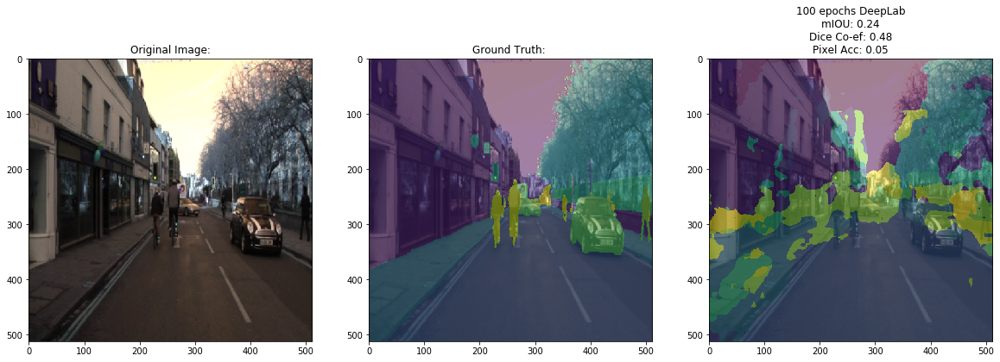

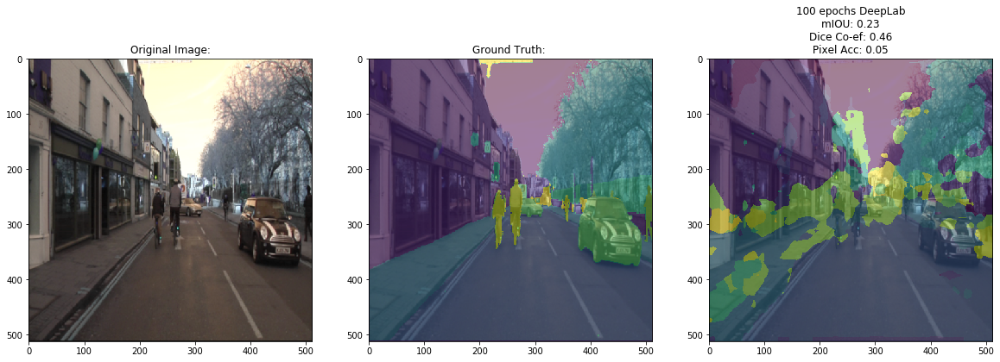

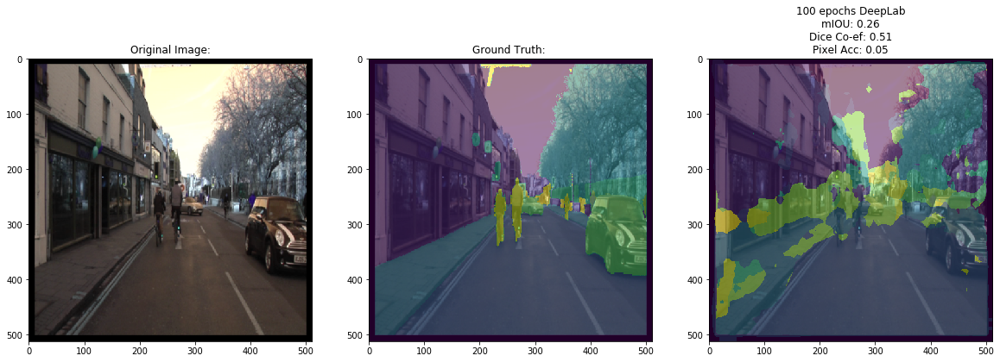

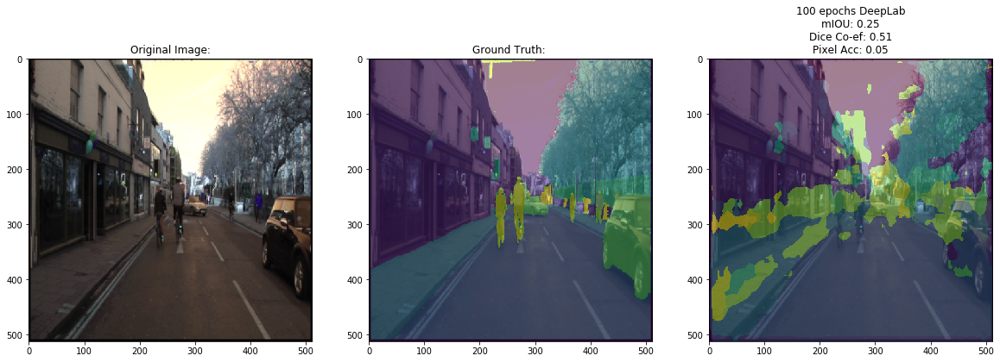

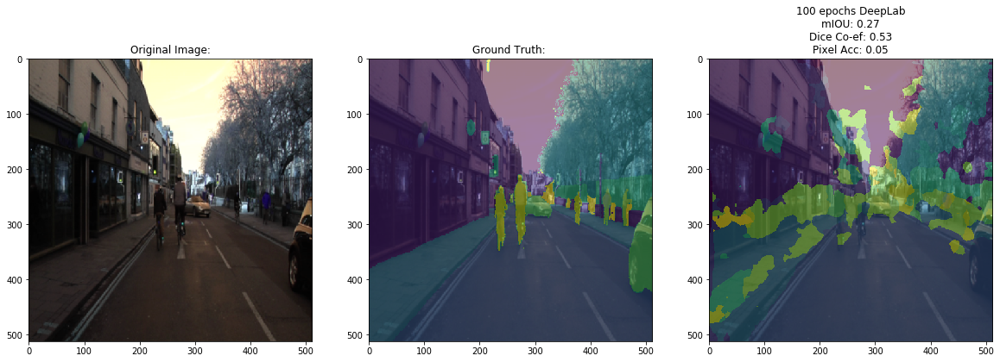

...

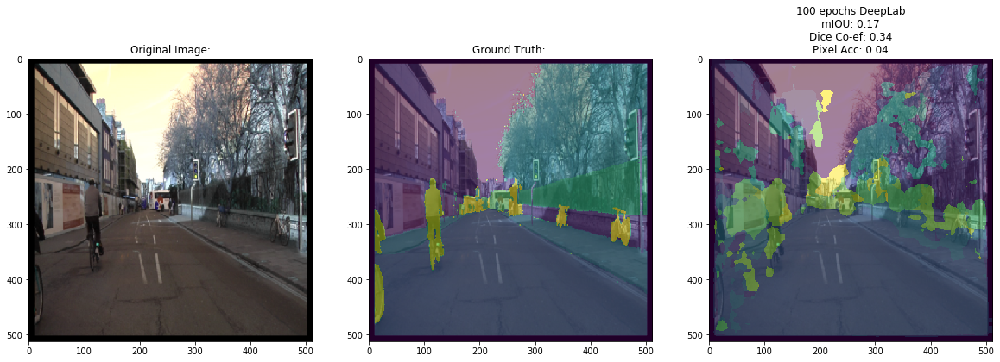

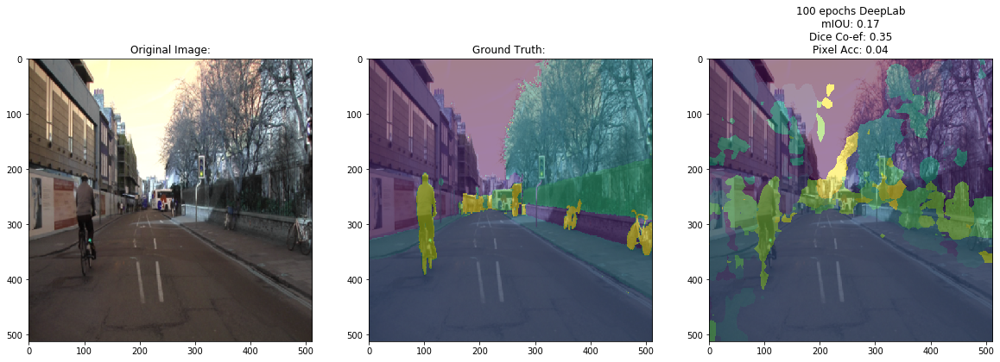

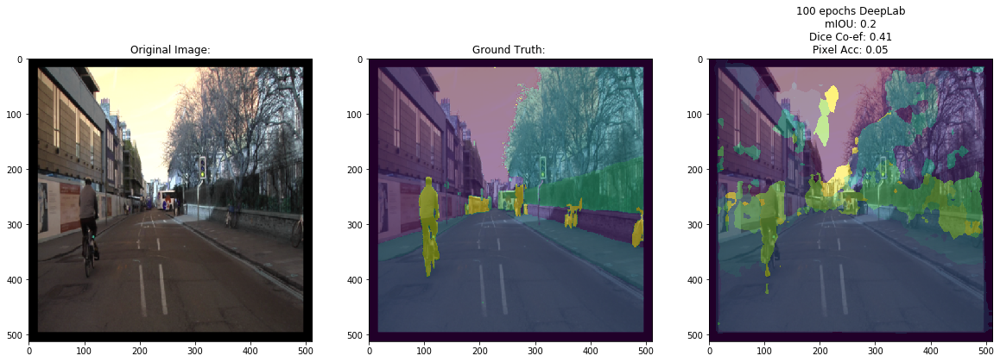

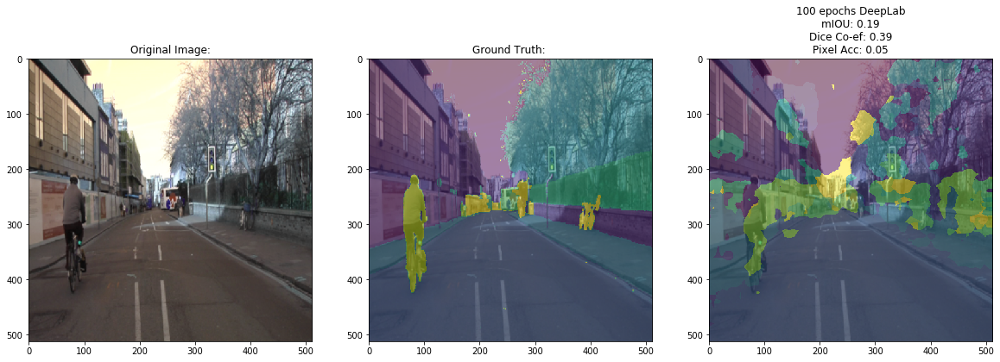

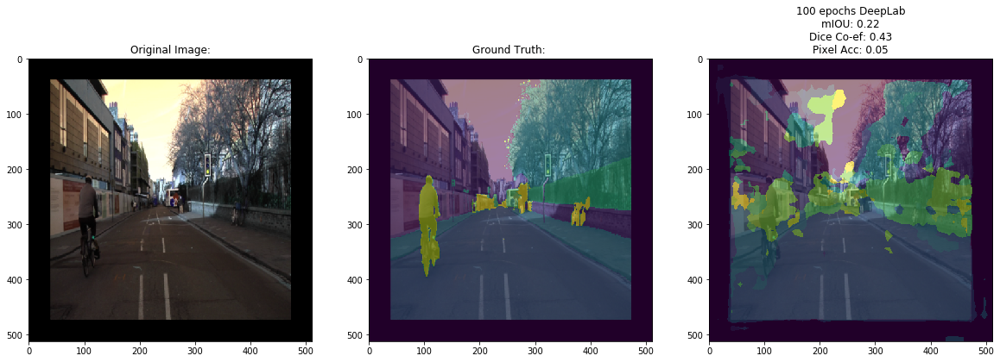

In [10]:
m_iou_over_the_data = 0
m_dice_coef_over_the_data = 0
m_PA_over_the_data = 0

for i in range(len(valid_generator)):
  #i = np.random.randint(0, len(valid_generator))
  #i = 1
  x,y,s = valid_generator.__getitem__(i)
  preds1 = np.argmax(model1.predict(x), -1)[0].reshape(image_size)
  preds2 = np.argmax(model2.predict(x), -1)[0].reshape(image_size)
  preds3 = np.argmax(model3.predict(x), -1)[0].reshape(image_size)

  im = x[0].astype('uint8')
  gt = y[0].reshape(image_size).astype('int32')

  plt.figure(figsize=(20,10))

  plt.subplot(131)
  plt.imshow(x[0].astype('uint8'))
  plt.title('Original Image:')

  plt.subplot(132)
  plt.imshow(x[0].astype('uint8'))
  plt.imshow(gt, alpha=.5)
  plt.title('Ground Truth: ')

  # plt.subplot(133)
  # plt.imshow(x[0].astype('uint8'))
  # plt.imshow(preds1, alpha=.5)
  # iou = mIOU(gt, preds2)
  # m_iou_over_the_data += iou
  # dice = dice_coef(gt, preds2)
  # m_dice_coef_over_the_data += dice
  # pa = pixel_acc(gt, preds2)
  # m_PA_over_the_data += pa
  # plt.title('10 epochs DeepLab\nmIOU: '+ str(iou)+ '\nDice Co-ef: '+ str(dice)+ '\nPixel Acc: '+ str(pa))

  # plt.subplot(133)
  # plt.imshow(x[0].astype('uint8'))
  # plt.imshow(preds2, alpha=.5)
  # iou = mIOU(gt, preds2)
  # m_iou_over_the_data += iou
  # dice = dice_coef(gt, preds2)
  # m_dice_coef_over_the_data += dice
  # pa = pixel_acc(gt, preds2)
  # m_PA_over_the_data += pa
  # plt.title('50 epochs DeepLab\nmIOU: '+ str(iou)+ '\nDice Co-ef: '+ str(dice)+ '\nPixel Acc: '+ str(pa))

  plt.subplot(133)
  plt.imshow(x[0].astype('uint8'))
  plt.imshow(preds2, alpha=.5)
  iou = mIOU(gt, preds2)
  m_iou_over_the_data += iou
  dice = dice_coef(gt, preds2)
  m_dice_coef_over_the_data += dice
  pa = pixel_acc(gt, preds2)
  m_PA_over_the_data += pa
  plt.title('100 epochs DeepLab\nmIOU: '+ str(iou)+ '\nDice Co-ef: '+ str(dice)+ '\nPixel Acc: '+ str(pa))

  plt.savefig('/content/drive/My Drive/results_DLV3_100_epochs/image_segmentation_plot_'+ str(i) +'.png')
print("m_iou_over_the_data:  ", m_iou_over_the_data/len(valid_generator))
print("m_dice_coef_over_the_data:  ", m_dice_coef_over_the_data/len(valid_generator))
print("m_PA_over_the_data:  ", m_PA_over_the_data/len(valid_generator))


# plt.subplot(143)
# MAP = do_crf(im, preds1, zero_unsure=False)
# plt.imshow(x[0].astype('uint8'))
# plt.imshow(MAP, alpha=.5)
# plt.title('Original DeepLab + CRF\nmIOU: '+str(mIOU(gt, MAP)))
# plt.subplot(144)
# MAP = do_crf(im, preds2, zero_unsure=False)
# plt.imshow(x[0].astype('uint8'))
# plt.imshow(MAP, alpha=.5)
# plt.title('Subpixel DeepLab + CRF\nmIOU: '+str(mIOU(gt, MAP)))

In [0]:

def calculate_iou(model, nb_classes = 21):
    SegClass.set_batch_size(1)
    valid_generator = SegClass.create_generators(crop_shape = None,mode = 'validation', n_classes = nb_classes,
                                                 horizontal_flip = False, vertical_flip = False,
                                                 brightness=0, rotation=False,
                                                 zoom=0, validation_split = .05, seed = 7, do_ahisteq = False)
    label = np.zeros((len(valid_generator),np.prod(image_size)), dtype='float32')
    X = np.zeros((len(valid_generator), image_size[0], image_size[1], 3), dtype='float32')
    for n in range(len(valid_generator)):
        x,y,_ = valid_generator.__getitem__(n)
        label[n,:] = y[0,:,0]
        X[n,:,:,:] = x
    preds = model.predict(X, batch_size=1)
    conf_m = np.zeros((nb_classes, nb_classes), dtype=float)
    total = 0
    mask = np.reshape(np.argmax(preds, axis=-1), (-1,) + image_size)
    flat_pred = np.ravel(mask).astype('int')
    flat_label = np.ravel(label).astype('int')
    for p, l in zip(flat_pred, flat_label):
        if l == nb_classes:
            continue
        if l < nb_classes and p < nb_classes:
            conf_m[l-1, p-1] += 1
        else:
            print('Invalid entry encountered, skipping! Label: ', l,
                    ' Prediction: ', p, ' Img_num: ', img_num)
    I = np.diag(conf_m)
    U = np.sum(conf_m, axis=0) + np.sum(conf_m, axis=1) - I
    IOU = I/U
    meanIOU = np.mean(IOU)
    return conf_m
conf_1 = calculate_iou(model1, nb_classes = 21)
conf_2 = calculate_iou(model2, nb_classes = 21)

classes = [c for c in get_Camvid_classes().values()][:-1]
plt.figure(figsize=(12,8))
plt.subplot(121)
cm1=plot_confusion_matrix(conf_1, classes, normalize=True)
plt.title('Original DeepLab\nMean IOU: '+ str(np.round(np.diag(cm1).mean(), 2)))
plt.subplot(122)
cm2=plot_confusion_matrix(conf_2, classes, normalize=True)
plt.title('Subpixel DeepLab\nMean IOU: '+ str(np.round(np.diag(cm2).mean(), 2)))